In [1]:
from semdiffusers import SemanticEditPipeline
import torch
torch.cuda.empty_cache()
device='cuda'

pipe = SemanticEditPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4",
    
    safety_checker=None,
).to(device)
gen = torch.Generator(device=device)

2023-07-24 10:18:40.299610: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-24 10:18:40.358125: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-24 10:18:43.110610: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/nfshomes/dyang5/CAAR/lib/python3.11/site-packages/semdiffusers/pipeline_latent_edit_diffusion.py:12: FutureWarning: Importing `DiffusionPipeline` or `ImagePipelineOutput` from diffusers.pipeline_utils is deprecated. Please import from diffusers.pipe

In [2]:
from PIL import Image
def image_grid(imgs, rows, cols, spacing = 20):
    assert len(imgs) == rows * cols
    
    w, h = imgs[0].size
    
    grid = Image.new('RGBA', size=(cols * w + (cols-1)*spacing, rows * h + (rows-1)*spacing ), color=(255,255,255,0))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=( i // rows * (w+spacing), i % rows * (h+spacing)))
        #print(( i // rows * w, i % rows * h))
    return grid

/nfshomes/dyang5/CAAR/lib/python3.11/site-packages/semdiffusers/pipeline_latent_edit_diffusion.py:376: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents_shape = (batch_size * num_images_per_prompt, self.unet.in_channels, height // 8, width // 8)


  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

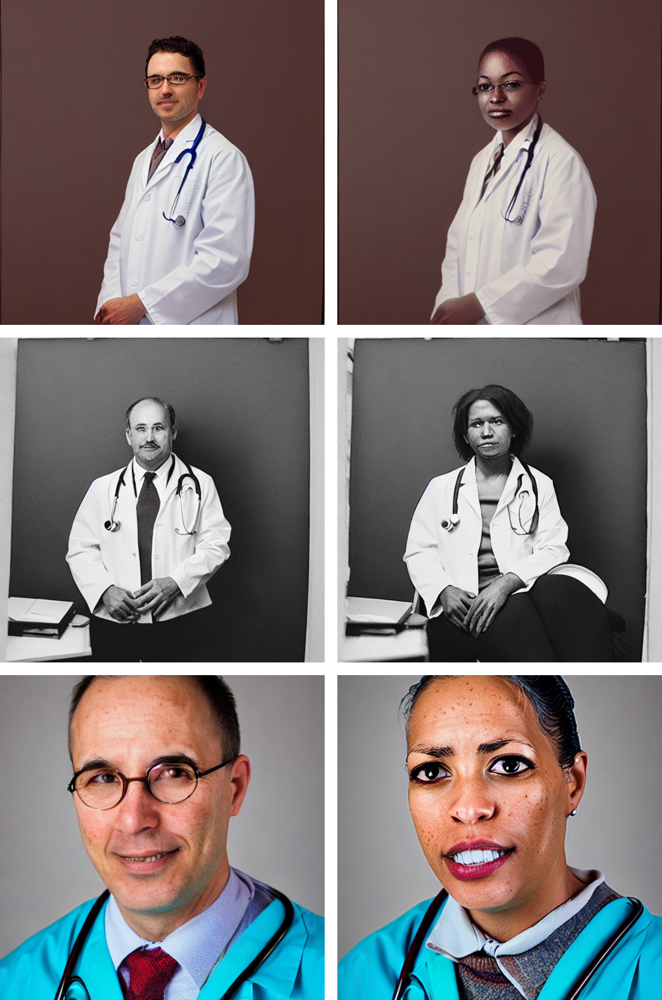

In [3]:
imgs = []
target = {'editing_prompt': ['black person', 'female'], 'reverse_editing_direction':[False, False], 
          'edit_warmup_steps':10, 'edit_guidance_scale':6, 'edit_threshold':0.95, 'edit_momentum_scale':0.5, 'edit_mom_beta': 0.6}

seed = 6
prompt = 'a portrait photo of a doctor'
gen.manual_seed(seed)
org = pipe(prompt=prompt, generator=gen, num_images_per_prompt=3, guidance_scale=7.5)
imgs.extend(org.images)

gen.manual_seed(seed)
out = pipe(prompt=prompt, generator=gen, num_images_per_prompt=3, guidance_scale=7.5,
       **target)
imgs.extend(out.images)

image_grid(imgs, rows=3, cols=2)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

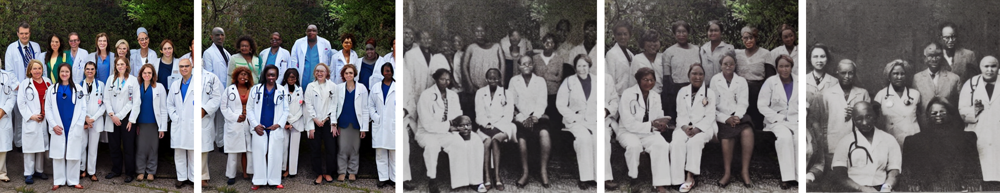

In [4]:
imgs = []

given_prompt = "a photo of a group of doctors"
len_hyperparameter = 4
warmup_steps = [15, 10, 8, 5]
guidance_scale = [15, 10, 8, 5]
threshold = [0.99, 0.975, 0.95, 0.9]
momentum_scale = [0.5, 0.4, 0.3, 0.2]
momentum_beta = [0.8, 0.7, 0.6, 0.5]
weights = [1, 0.9, 0.8, 0.75]

seed = 5

gen.manual_seed(seed)
out = pipe(prompt = given_prompt, generator = gen, num_images_per_prompt = 1)
imgs.extend(out.images)
for i in range(len_hyperparameter):
    a = warmup_steps[i]
    b = guidance_scale[i]
    c = threshold[i]
    d = momentum_scale[i]
    e = momentum_beta[i]
    f = weights[i]


    gen.manual_seed(seed)
    out = pipe(prompt=given_prompt, generator=gen, num_images_per_prompt=1, guidance_scale=7,
               editing_prompt=['female', 'black person'],
               reverse_editing_direction=[False, False], # Direction of guidance i.e. increase all concepts
               edit_warmup_steps=[a, a], # Warmup period for each concept
               edit_guidance_scale=[b, b], # Guidance scale for each concept
               edit_threshold=[c, c], # Threshold for each concept. Threshold equals the percentile of the latent space that will be discarded. I.e. threshold=0.99 uses 1% of the latent dimensions
               edit_momentum_scale=d, # Momentum scale that will be added to the latent guidance
               edit_mom_beta=e, # Momentum beta
               edit_weights=[f, f] # Weights of the individual concepts against each other              
              )
    imgs.extend(out.images)

image_grid(imgs, rows = 1, cols = 5)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

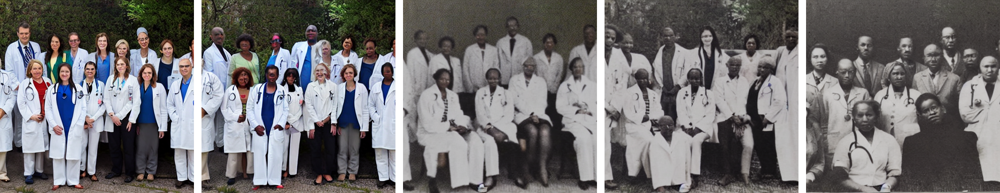

In [5]:
imgs = []

given_prompt = "a photo of a group of doctors"
len_hyperparameter = 4
warmup_steps = [15, 10, 8, 5]
guidance_scale = [15, 10, 8, 5]
threshold = [0.99, 0.975, 0.95, 0.9]
momentum_scale = [0.5, 0.4, 0.3, 0.2]
momentum_beta = [0.8, 0.7, 0.6, 0.5]
weights = [1, 0.9, 0.8, 0.75]

seed = 5

gen.manual_seed(seed)
out = pipe(prompt = given_prompt, generator = gen, num_images_per_prompt = 1)
imgs.extend(out.images)
for i in range(len_hyperparameter):
    a = warmup_steps[i]
    b = guidance_scale[i]
    c = threshold[i]
    d = momentum_scale[i]
    e = momentum_beta[i]
    f = weights[i]


    gen.manual_seed(seed)
    out = pipe(prompt=given_prompt, generator=gen, num_images_per_prompt=1, guidance_scale=7,
               editing_prompt=['female', 'african american'],
               reverse_editing_direction=[False, False], # Direction of guidance i.e. increase all concepts
               edit_warmup_steps=[a, a], # Warmup period for each concept
               edit_guidance_scale=[b, b], # Guidance scale for each concept
               edit_threshold=[c, c], # Threshold for each concept. Threshold equals the percentile of the latent space that will be discarded. I.e. threshold=0.99 uses 1% of the latent dimensions
               edit_momentum_scale=d, # Momentum scale that will be added to the latent guidance
               edit_mom_beta=e, # Momentum beta
               edit_weights=[f, f] # Weights of the individual concepts against each other              
              )
    imgs.extend(out.images)

image_grid(imgs, rows = 1, cols = 5)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

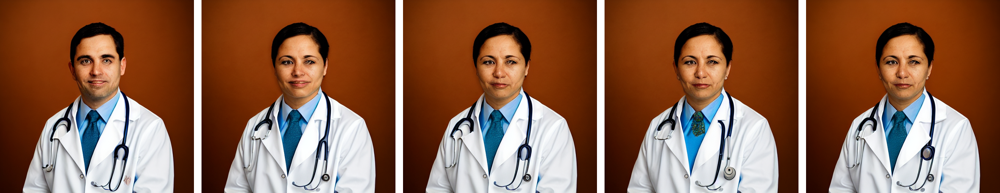

In [6]:
num_parameters = 6
seed = 10

imgs = []

given_prompt = "a portrait photo of a doctor"
i = 0
gen.manual_seed(seed)
out = pipe(prompt = given_prompt, generator = gen, num_images_per_prompt = 1)
imgs.extend(out.images)
for j in range(len_hyperparameter):
    # default in Fair Diffusion paper
    a, b, c, d, e, f = 10, 4, 0.95, 0.5, 0.6, 1  
    if (i == 0):
        a = warmup_steps[j]
    elif (i == 1):
        b = guidance_scale[j]
    elif (i == 2):
        c = threshold[j]
    elif (i == 3):
        d = momentum_scale[j]
    elif (i == 4):
        e = momentum_beta[j]
    elif (i == 5):
        f = weights[j]

    gen.manual_seed(seed)
    out = pipe(prompt=given_prompt, generator=gen, num_images_per_prompt=1, guidance_scale=7,
               editing_prompt=['female', 'white person'],
               reverse_editing_direction=[False, True], # Direction of guidance i.e. increase all concepts
               edit_warmup_steps=[a, a], # Warmup period for each concept
               edit_guidance_scale=[b, b], # Guidance scale for each concept
               edit_threshold=[c, c], # Threshold for each concept. Threshold equals the percentile of the latent space that will be discarded. I.e. threshold=0.99 uses 1% of the latent dimensions
               edit_momentum_scale=d, # Momentum scale that will be added to the latent guidance
               edit_mom_beta=e, # Momentum beta
               edit_weights=[f, f] # Weights of the individual concepts against each other
              )
    imgs.extend(out.images)

image_grid(imgs, rows = 1, cols = 5)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

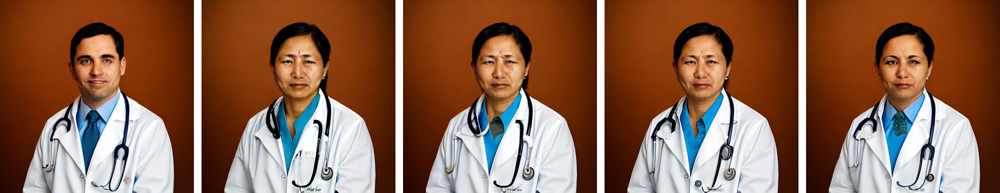

In [8]:
num_parameters = 6
seed = 10

imgs = []

given_prompt = "a portrait photo of a doctor"
i = 1
gen.manual_seed(seed)
out = pipe(prompt = given_prompt, generator = gen, num_images_per_prompt = 1)
imgs.extend(out.images)
for j in range(len_hyperparameter):
    # default in Fair Diffusion paper
    a, b, c, d, e, f = 10, 4, 0.95, 0.5, 0.6, 1  
    if (i == 0):
        a = warmup_steps[j]
    elif (i == 1):
        b = guidance_scale[j]
    elif (i == 2):
        c = threshold[j]
    elif (i == 3):
        d = momentum_scale[j]
    elif (i == 4):
        e = momentum_beta[j]
    elif (i == 5):
        f = weights[j]

    gen.manual_seed(seed)
    out = pipe(prompt=given_prompt, generator=gen, num_images_per_prompt=1, guidance_scale=7,
               editing_prompt=['female', 'white person'],
               reverse_editing_direction=[False, True], # Direction of guidance i.e. increase all concepts
               edit_warmup_steps=[a, a], # Warmup period for each concept
               edit_guidance_scale=[b, b], # Guidance scale for each concept
               edit_threshold=[c, c], # Threshold for each concept. Threshold equals the percentile of the latent space that will be discarded. I.e. threshold=0.99 uses 1% of the latent dimensions
               edit_momentum_scale=d, # Momentum scale that will be added to the latent guidance
               edit_mom_beta=e, # Momentum beta
               edit_weights=[f, f] # Weights of the individual concepts against each other
              )
    imgs.extend(out.images)

image_grid(imgs, rows = 1, cols = 5)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

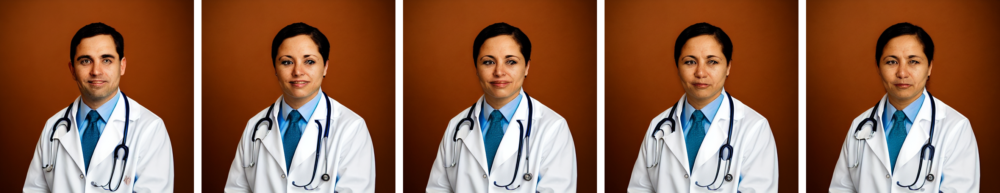

In [7]:
num_parameters = 6
seed = 10

imgs = []

given_prompt = "a portrait photo of a doctor"
i = 2
gen.manual_seed(seed)
out = pipe(prompt = given_prompt, generator = gen, num_images_per_prompt = 1)
imgs.extend(out.images)
for j in range(len_hyperparameter):
    # default in Fair Diffusion paper
    a, b, c, d, e, f = 10, 4, 0.95, 0.5, 0.6, 1  
    if (i == 0):
        a = warmup_steps[j]
    elif (i == 1):
        b = guidance_scale[j]
    elif (i == 2):
        c = threshold[j]
    elif (i == 3):
        d = momentum_scale[j]
    elif (i == 4):
        e = momentum_beta[j]
    elif (i == 5):
        f = weights[j]

    gen.manual_seed(seed)
    out = pipe(prompt=given_prompt, generator=gen, num_images_per_prompt=1, guidance_scale=7,
               editing_prompt=['female', 'white person'],
               reverse_editing_direction=[False, True], # Direction of guidance i.e. increase all concepts
               edit_warmup_steps=[a, a], # Warmup period for each concept
               edit_guidance_scale=[b, b], # Guidance scale for each concept
               edit_threshold=[c, c], # Threshold for each concept. Threshold equals the percentile of the latent space that will be discarded. I.e. threshold=0.99 uses 1% of the latent dimensions
               edit_momentum_scale=d, # Momentum scale that will be added to the latent guidance
               edit_mom_beta=e, # Momentum beta
               edit_weights=[f, f] # Weights of the individual concepts against each other
              )
    imgs.extend(out.images)

image_grid(imgs, rows = 1, cols = 5)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

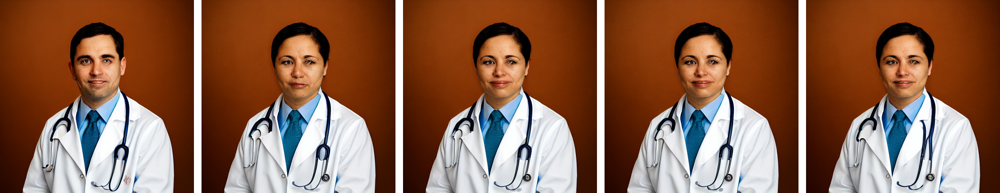

In [9]:
num_parameters = 6
seed = 10

imgs = []

given_prompt = "a portrait photo of a doctor"
i = 3
gen.manual_seed(seed)
out = pipe(prompt = given_prompt, generator = gen, num_images_per_prompt = 1)
imgs.extend(out.images)
for j in range(len_hyperparameter):
    # default in Fair Diffusion paper
    a, b, c, d, e, f = 10, 4, 0.95, 0.5, 0.6, 1  
    if (i == 0):
        a = warmup_steps[j]
    elif (i == 1):
        b = guidance_scale[j]
    elif (i == 2):
        c = threshold[j]
    elif (i == 3):
        d = momentum_scale[j]
    elif (i == 4):
        e = momentum_beta[j]
    elif (i == 5):
        f = weights[j]

    gen.manual_seed(seed)
    out = pipe(prompt=given_prompt, generator=gen, num_images_per_prompt=1, guidance_scale=7,
               editing_prompt=['female', 'white person'],
               reverse_editing_direction=[False, True], # Direction of guidance i.e. increase all concepts
               edit_warmup_steps=[a, a], # Warmup period for each concept
               edit_guidance_scale=[b, b], # Guidance scale for each concept
               edit_threshold=[c, c], # Threshold for each concept. Threshold equals the percentile of the latent space that will be discarded. I.e. threshold=0.99 uses 1% of the latent dimensions
               edit_momentum_scale=d, # Momentum scale that will be added to the latent guidance
               edit_mom_beta=e, # Momentum beta
               edit_weights=[f, f] # Weights of the individual concepts against each other
              )
    imgs.extend(out.images)

image_grid(imgs, rows = 1, cols = 5)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

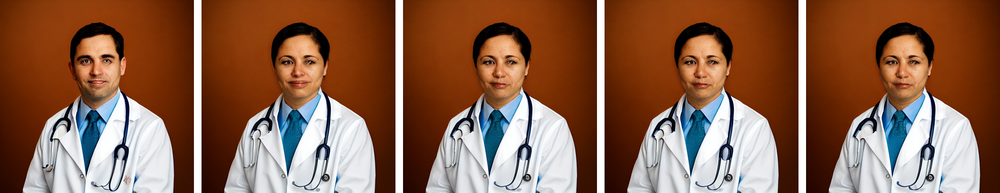

In [10]:
num_parameters = 6
seed = 10

imgs = []

given_prompt = "a portrait photo of a doctor"
i = 4
gen.manual_seed(seed)
out = pipe(prompt = given_prompt, generator = gen, num_images_per_prompt = 1)
imgs.extend(out.images)
for j in range(len_hyperparameter):
    # default in Fair Diffusion paper
    a, b, c, d, e, f = 10, 4, 0.95, 0.5, 0.6, 1  
    if (i == 0):
        a = warmup_steps[j]
    elif (i == 1):
        b = guidance_scale[j]
    elif (i == 2):
        c = threshold[j]
    elif (i == 3):
        d = momentum_scale[j]
    elif (i == 4):
        e = momentum_beta[j]
    elif (i == 5):
        f = weights[j]

    gen.manual_seed(seed)
    out = pipe(prompt=given_prompt, generator=gen, num_images_per_prompt=1, guidance_scale=7,
               editing_prompt=['female', 'white person'],
               reverse_editing_direction=[False, True], # Direction of guidance i.e. increase all concepts
               edit_warmup_steps=[a, a], # Warmup period for each concept
               edit_guidance_scale=[b, b], # Guidance scale for each concept
               edit_threshold=[c, c], # Threshold for each concept. Threshold equals the percentile of the latent space that will be discarded. I.e. threshold=0.99 uses 1% of the latent dimensions
               edit_momentum_scale=d, # Momentum scale that will be added to the latent guidance
               edit_mom_beta=e, # Momentum beta
               edit_weights=[f, f] # Weights of the individual concepts against each other
              )
    imgs.extend(out.images)

image_grid(imgs, rows = 1, cols = 5)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

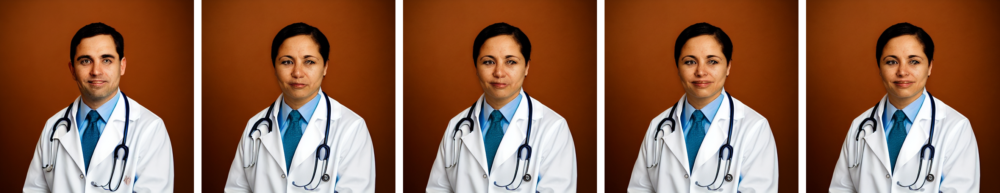

In [11]:
num_parameters = 6
seed = 10

imgs = []

given_prompt = "a portrait photo of a doctor"
i = 5
gen.manual_seed(seed)
out = pipe(prompt = given_prompt, generator = gen, num_images_per_prompt = 1)
imgs.extend(out.images)
for j in range(len_hyperparameter):
    # default in Fair Diffusion paper
    a, b, c, d, e, f = 10, 4, 0.95, 0.5, 0.6, 1  
    if (i == 0):
        a = warmup_steps[j]
    elif (i == 1):
        b = guidance_scale[j]
    elif (i == 2):
        c = threshold[j]
    elif (i == 3):
        d = momentum_scale[j]
    elif (i == 4):
        e = momentum_beta[j]
    elif (i == 5):
        f = weights[j]

    gen.manual_seed(seed)
    out = pipe(prompt=given_prompt, generator=gen, num_images_per_prompt=1, guidance_scale=7,
               editing_prompt=['female', 'white person'],
               reverse_editing_direction=[False, True], # Direction of guidance i.e. increase all concepts
               edit_warmup_steps=[a, a], # Warmup period for each concept
               edit_guidance_scale=[b, b], # Guidance scale for each concept
               edit_threshold=[c, c], # Threshold for each concept. Threshold equals the percentile of the latent space that will be discarded. I.e. threshold=0.99 uses 1% of the latent dimensions
               edit_momentum_scale=d, # Momentum scale that will be added to the latent guidance
               edit_mom_beta=e, # Momentum beta
               edit_weights=[f, f] # Weights of the individual concepts against each other
              )
    imgs.extend(out.images)

image_grid(imgs, rows = 1, cols = 5)

In [12]:
num_parameters = 6
seed = 10

imgs = []

given_prompt = "a portrait photo of a doctor"
for i in range(num_parameters):
    gen.manual_seed(seed)
    out = pipe(prompt = given_prompt, generator = gen, num_images_per_prompt = 1)
    imgs.extend(out.images)
    for j in range(len_hyperparameter):
        # default in Fair Diffusion paper
        a, b, c, d, e, f = 10, 4, 0.95, 0.5, 0.6, 1  
        if (i == 0):
            a = warmup_steps[j]
        elif (i == 1):
            b = guidance_scale[j]
        elif (i == 2):
            c = threshold[j]
        elif (i == 3):
            d = momentum_scale[j]
        elif (i == 4):
            e = momentum_beta[j]
        elif (i == 5):
            f = weights[j]

        gen.manual_seed(seed)
        out = pipe(prompt=given_prompt, generator=gen, num_images_per_prompt=1, guidance_scale=7,
                   editing_prompt=['female', 'white person'],
                   reverse_editing_direction=[False, True], # Direction of guidance i.e. increase all concepts
                   edit_warmup_steps=[a, a], # Warmup period for each concept
                   edit_guidance_scale=[b, b], # Guidance scale for each concept
                   edit_threshold=[c, c], # Threshold for each concept. Threshold equals the percentile of the latent space that will be discarded. I.e. threshold=0.99 uses 1% of the latent dimensions
                   edit_momentum_scale=d, # Momentum scale that will be added to the latent guidance
                   edit_mom_beta=e, # Momentum beta
                   edit_weights=[f, f] # Weights of the individual concepts against each other
                  )
        imgs.extend(out.images)

image_grid(imgs, rows = 5, cols = 6)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]